<a href="https://colab.research.google.com/github/archie46/Computer-Vision-Labarotary/blob/main/BGS.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# BGS based tracking
import cv2
import numpy as np
import matplotlib.pyplot as plt
from numpy.lib.type_check import imag
from g

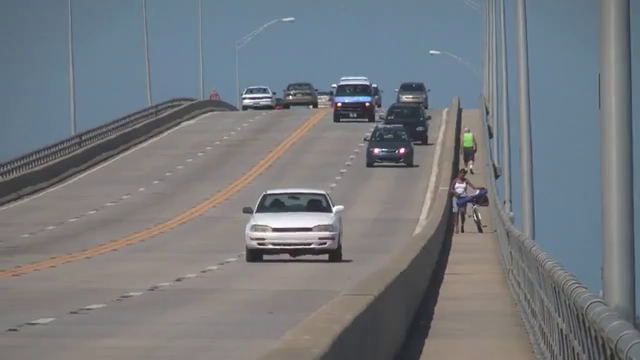

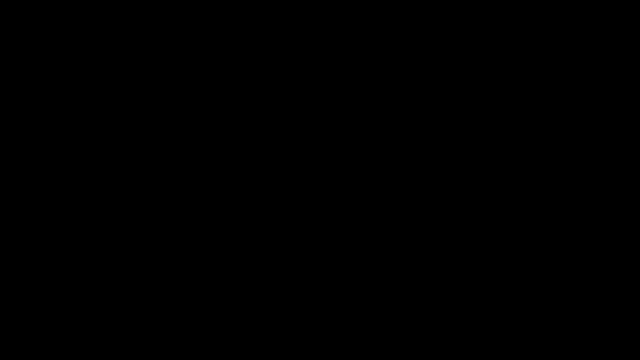

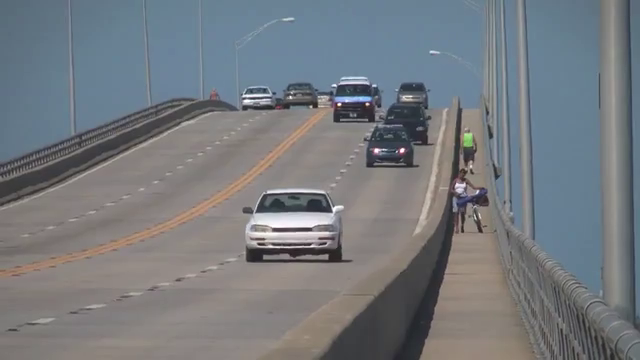

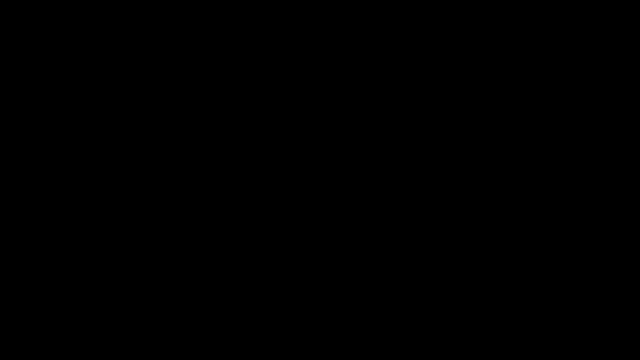

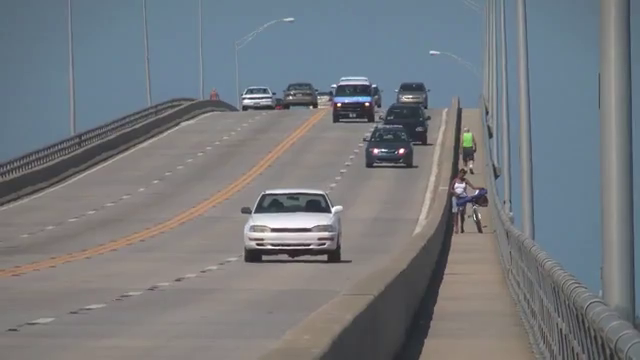

...

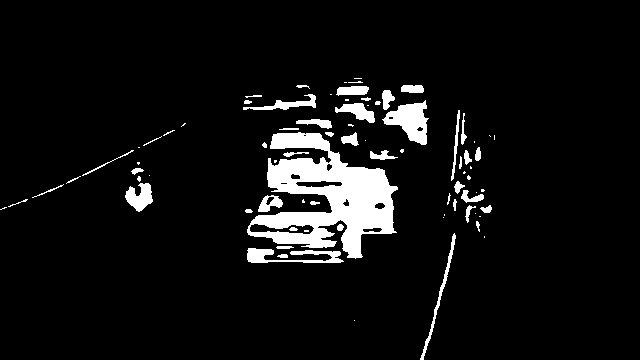

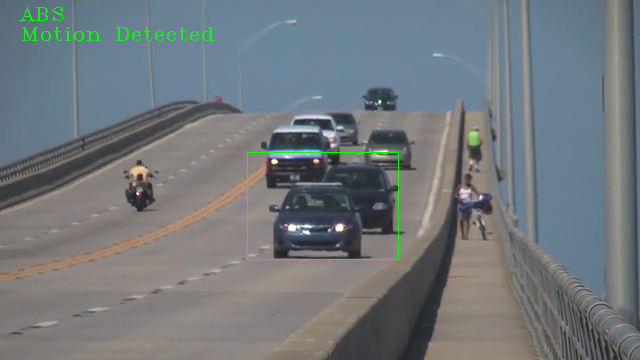

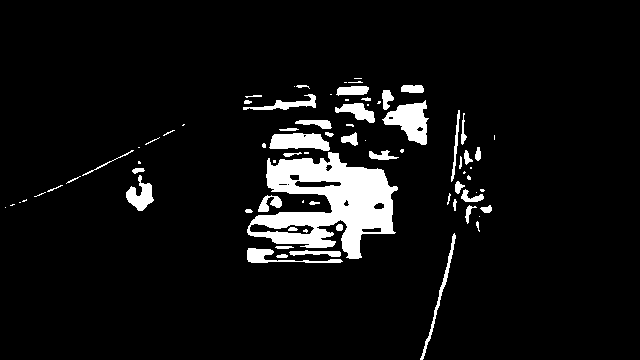

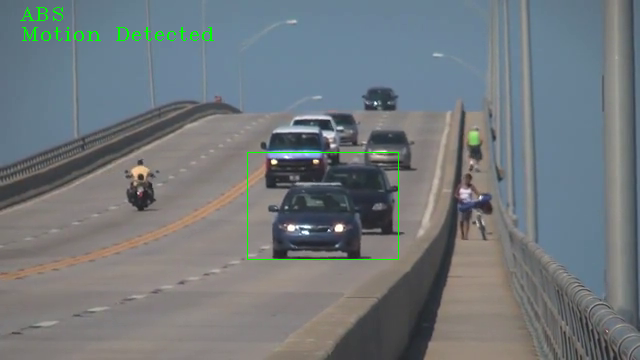

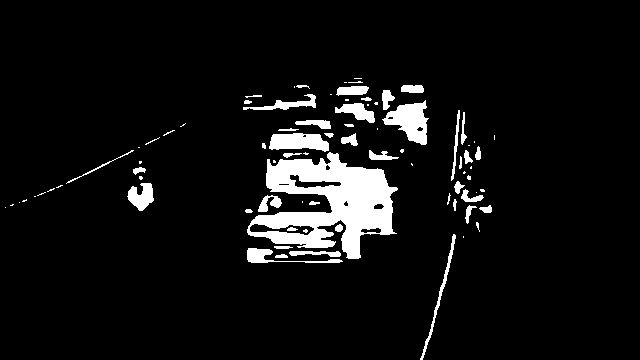

Buffered data was truncated after reaching the output size limit.

In [ ]:
minimum = 4000                  #Define Min Contour area
frame1 = None

cap = cv2.VideoCapture('slow_traffic_small.mp4')   # Capture object to access the camera
method = 'ABS'

# Background Subtraction Methods
mog = cv2.createBackgroundSubtractorMOG2()
knn = cv2.createBackgroundSubtractorKNN()

while True:
    ret, frame = cap.read()
    vid = cv2.flip(frame,1)

    if method == 'MOG2':
        bgs = mog.apply(vid)


    elif method == 'KNN':
        bgs = knn.apply(vid)
# Using Frame difference method to find the change in the scene. Current frame
# is subtracted from the first frame which is assumed to be static and contains no
# Foreground object.

    elif method == 'ABS':
        frame = cv2.GaussianBlur(vid,(7,7),0)
        frame = cv2.cvtColor(frame,cv2.COLOR_BGR2GRAY)

        if frame1 is None:
            frame1 = frame
            continue

        framedelta = cv2.absdiff(frame1,frame)
        retval, bgs = cv2.threshold(framedelta.copy(), 50, 255, cv2.THRESH_BINARY)

    mask = np.zeros_like(frame)

# Finding contours and Draw them of the frame

    contours,_ = cv2.findContours(bgs, mode= cv2.RETR_TREE, method= cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours,key=cv2.contourArea,reverse= True)

    for cnt in contours:
        if cv2.contourArea(cnt) < minimum:
                continue

        (x,y,w,h) = cv2.boundingRect(cnt)
        cv2.rectangle(vid,(x,y),(x+w,y+h),(0,255,10),1)
        cv2.putText(vid,f'{method}',(20,20),cv2.FONT_HERSHEY_COMPLEX_SMALL,1,(0,255,0,2))
        cv2.putText(vid,'Motion Detected',(20,40),cv2.FONT_HERSHEY_COMPLEX_SMALL,1,(0,255,0,2))
        #cv2.drawContours(bgs,cnt,-1,255,3)
        cv2.drawContours(mask,cnt,-1,255,3)
        break

    cv2_imshow('frame',vid)
    cv2_imshow('BGS',bgs)

cap.release()